#Assignment 4: Feature Engineering

### Group Members

**Group Name:** 3H

| Name                                     | Matrix Number  
| :---------------------------------------- | :-------------: |
| NG ZI XING | A21EC0213
| MOHAMAD AZRI HADIF BIN MOHAMMAD RIZAL | A21EC0054
| ALIEYA ZAWANIE BINTI A ZAINI | A21EC0156
| IZZAT HAQEEMI BIN HAIRUDIN | A21EC0033  

###About Data
The Data is from 3 different csv file which over 70,000,000 of records, 44 columns, over 8.0GB of data, if we join them directly. The seperating of them enable us to conduct the feature engineering on them one by one without crashing.

###Motivation

The [Anime Data](https://www.kaggle.com/datasets/dbdmobile/myanimelist-dataset/) is from the kaggle website.Anime is a popular form of entertainment originating from Japan. It encompasses a wide range of animated TV series, movies, and OVAs (original video animations) that cater to various genres and target audiences. Anime is known for its distinctive art style, compelling storytelling, and diverse themes.Anime covers a vast array of genres, including action, adventure, comedy, drama, romance, fantasy, sci-fi, and many more. Each genre offers unique storytelling elements and appeals to different preferences and interests among anime enthusiasts.Due to the vast number of anime titles available, **Recommendations play a crucial role in helping enthusiasts discover new shows that align with their interests.** Recommendation systems leverage user ratings, genres, and other factors to suggest anime series that users might enjoy based on their preferences.

###Goal

The objective of this notebook is to leverage three primary .csv datasets—namely, anime-dataset-2023.csv, users-details-2023.csv, and users-score-2023.csv—to construct an effective dataset that will be instrumental in the future development of a recommendation system.











## Loading Dataset

This notebook utilizes the Kaggle official API to directly load the dataset into Colab. However, to proceed, you'll need the "kaggle.json" file, which can be obtained by following these steps: Go to the Kaggle website, navigate to your profile, access the account settings, and create a new token. Once you obtain the "kaggle.json" file, execute the cell below and upload your "kaggle.json" file.

In [ ]:
from google.colab import files

files.upload()
!mkdir ~/.kaggle
!mv kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d dbdmobile/myanimelist-dataset

Saving kaggle.json to kaggle.json
 99% 1.78G/1.80G [00:15<00:00, 154MB/s]
100% 1.80G/1.80G [00:15<00:00, 127MB/s]


### Preparation

This part is to import the nessecarry library, including pandas, numpy ,tensorflow and more.

In [ ]:
!pip install -U tensorflow
!pip install tensorflow_hub
!pip install tensorflow_text
!pip install -U scikit-learn

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from zipfile import ZipFile
import gc

Extract the downloaded zip data

In [ ]:
filepath = "/content/myanimelist-dataset.zip"

with ZipFile(filepath) as zip:
  zip.printdir()
  zip.extractall()

!rm /content/myanimelist-dataset.zip

File Name                                             Modified             Size
anime-dataset-2023.csv                         2023-07-28 04:36:40     15924739
anime-filtered.csv                             2023-07-28 04:36:40      9722413
final_animedataset.csv                         2023-07-28 04:37:18   4549801910
user-filtered.csv                              2023-07-28 04:41:36   1545214210
users-details-2023.csv                         2023-07-28 04:43:10     73927314
users-score-2023.csv                           2023-07-28 04:43:14   1157881770


### Import User detail dataset

**Brief Structure of users-details-2023.csv**
- **Mal ID:** Unique ID for each user.
- **Username:** The username of the user.
- **Gender:** The gender of the user.
- **Birthday:** The birthday of the user (in ISO format).
- **Location:** The location or country of the user.
- **Joined:** The date when the user joined the platform (in ISO format).
- **Days Watched:** The total number of days the user has spent watching anime.
- **Mean Score:** The average score given by the user to the anime they have watched.
- **Watching:** The number of anime currently being watched by the user.
- **Completed:** The number of anime completed by the user.
- **On Hold:** The number of anime on hold by the user.
- **Dropped:** The number of anime dropped by the user.
- **Plan to Watch:** The number of anime the user plans to watch in the future.
- **Total Entries:** The total number of anime entries in the user's list.
- **Rewatched:** The number of anime rewatched by the user.
- **Episodes Watched:** The total number of episodes watched by the user.

In [117]:
user_detail = pd.read_csv("/content/users-details-2023.csv", index_col = 0)
user_detail.head()

,Username,Gender,Birthday,Location,Joined,Days Watched,Mean Score,Watching,Completed,On Hold,Dropped,Plan to Watch,Total Entries,Rewatched,Episodes Watched
Mal ID,,,,,,,,,,,,,,,
1,Xinil,Male,1985-03-04T00:00:00+00:00,California,2004-11-05T00:00:00+00:00,142.3,7.37,1.0,233.0,8.0,93.0,64.0,399.0,60.0,8458.0
3,Aokaado,Male,NaN,"Oslo, Norway",2004-11-11T00:00:00+00:00,68.6,7.34,23.0,137.0,99.0,44.0,40.0,343.0,15.0,4072.0
4,Crystal,Female,NaN,"Melbourne, Australia",2004-11-13T00:00:00+00:00,212.8,6.68,16.0,636.0,303.0,0.0,45.0,1000.0,10.0,12781.0
9,Arcane,NaN,NaN,NaN,2004-12-05T00:00:00+00:00,30.0,7.71,5.0,54.0,4.0,3.0,0.0,66.0,0.0,1817.0
18,Mad,NaN,NaN,NaN,2005-01-03T00:00:00+00:00,52.0,6.27,1.0,114.0,10.0,5.0,23.0,153.0,42.0,3038.0


In [ ]:
# change the index name to "user_id" instead of "Mal ID"

user_detail.index.name = "user_id"

### Import anime dataset

**Brief structure of anime-dataset-2023.csv**
- **anime_id:** Unique ID for each anime.
- **Name:** The name of the anime in its original language.
- **English name:** The English name of the anime.
- **Other name:** Native name or title of the anime (can be in Japanese, Chinese, or Korean).
- **Score:** The score or rating given to the anime.
- **Genres:** The genres of the anime, separated by commas.
- **Synopsis:** A brief description or summary of the anime's plot.
- **Type:** The type of the anime (e.g., TV series, movie, OVA, etc.).
- **Episodes:** The number of episodes in the anime.
- **Aired:** The dates when the anime was aired.
- **Premiered:** The season and year when the anime premiered.
- **Status:** The status of the anime (e.g., Finished Airing, Currently Airing, etc.).
- **Producers:** The production companies or producers of the anime.
- **Licensors:** The licensors of the anime (e.g., streaming platforms).
- **Studios:** The animation studios that worked on the anime.
- **Source:** The source material of the anime (e.g., manga, light novel, original).
- **Duration:** The duration of each episode.
- **Rating:** The age rating of the anime.
- **Rank:** The rank of the anime based on popularity or other criteria.
- **Popularity:** The popularity rank of the anime.
- **Favorites:** The number of times the anime was marked as a favorite by users.
- **Scored By:** The number of users who scored the anime.
- **Members:** The number of members who have added the anime to their list on the platform.
- **Image URL:** The URL of the anime's image or poster.

In [ ]:
anime = pd.read_csv("/content/anime-dataset-2023.csv", index_col = 0)
anime.head()

,Name,English name,Other name,Score,Genres,Synopsis,Type,Episodes,Aired,Premiered,...,Studios,Source,Duration,Rating,Rank,Popularity,Favorites,Scored By,Members,Image URL
anime_id,,,,,,,,,,,,,,,,,,,,,
1,Cowboy Bebop,Cowboy Bebop,カウボーイビバップ,8.75,"Action, Award Winning, Sci-Fi","Crime is timeless. By the year 2071, humanity ...",TV,26.0,"Apr 3, 1998 to Apr 24, 1999",spring 1998,...,Sunrise,Original,24 min per ep,R - 17+ (violence & profanity),41.0,43,78525,914193.0,1771505,https://cdn.myanimelist.net/images/anime/4/196...
5,Cowboy Bebop: Tengoku no Tobira,Cowboy Bebop: The Movie,カウボーイビバップ 天国の扉,8.38,"Action, Sci-Fi","Another day, another bounty—such is the life o...",Movie,1.0,"Sep 1, 2001",UNKNOWN,...,Bones,Original,1 hr 55 min,R - 17+ (violence & profanity),189.0,602,1448,206248.0,360978,https://cdn.myanimelist.net/images/anime/1439/...
6,Trigun,Trigun,トライガン,8.22,"Action, Adventure, Sci-Fi","Vash the Stampede is the man with a $$60,000,0...",TV,26.0,"Apr 1, 1998 to Sep 30, 1998",spring 1998,...,Madhouse,Manga,24 min per ep,PG-13 - Teens 13 or older,328.0,246,15035,356739.0,727252,https://cdn.myanimelist.net/images/anime/7/203...
7,Witch Hunter Robin,Witch Hunter Robin,Witch Hunter ROBIN (ウイッチハンターロビン),7.25,"Action, Drama, Mystery, Supernatural",Robin Sena is a powerful craft user drafted in...,TV,26.0,"Jul 3, 2002 to Dec 25, 2002",summer 2002,...,Sunrise,Original,25 min per ep,PG-13 - Teens 13 or older,2764.0,1795,613,42829.0,111931,https://cdn.myanimelist.net/images/anime/10/19...
8,Bouken Ou Beet,Beet the Vandel Buster,冒険王ビィト,6.94,"Adventure, Fantasy, Supernatural",It is the dark century and the people are suff...,TV,52.0,"Sep 30, 2004 to Sep 29, 2005",fall 2004,...,Toei Animation,Manga,23 min per ep,PG - Children,4240.0,5126,14,6413.0,15001,https://cdn.myanimelist.net/images/anime/7/215...


### Import user score dataset

This csv contain the data about the rating of each user to different anime.

The rating column in this .csv is our target value which is to predict a how much is the score that a user will rate to an anime.

**Brief structure of users-score-2023.csv**
- **user_id:** Unique ID for each user.
- **Username:** The username of the user.
- **anime_id:** Unique ID for each anime.
- **Anime Title:** The title of the anime.
- **rating:** The rating given by the user to the anime.

In [119]:
user_score = pd.read_csv("/content/users-score-2023.csv")
user_score.head()

,user_id,Username,anime_id,Anime Title,rating
0,1,Xinil,21,One Piece,9
1,1,Xinil,48,.hack//Sign,7
2,1,Xinil,320,A Kite,5
3,1,Xinil,49,Aa! Megami-sama!,8
4,1,Xinil,304,Aa! Megami-sama! Movie,8


## Basic EDA

This part is to realize the basic components of each columns including the value composed, the datatype and missing value for further analysis and facilitate the workflow.

### User Detail

From the info listed below, we can know the total number of user exists in this data is 731290 and other column with unaligned Non-NUll count implies that column including NaN value. There are only object and float64 datatype exists and all data has the correct dataype exlude Birthday should have date datatype. Lets explore the missing value columns one by one.

In [ ]:
user_detail.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 731290 entries, 1 to 1291097
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Username          731290 non-null  object 
 1   Gender            224383 non-null  object 
 2   Birthday          168068 non-null  object 
 3   Location          152806 non-null  object 
 4   Joined            731290 non-null  object 
 5   Days Watched      731282 non-null  float64
 6   Mean Score        731282 non-null  float64
 7   Watching          731282 non-null  float64
 8   Completed         731282 non-null  float64
 9   On Hold           731282 non-null  float64
 10  Dropped           731282 non-null  float64
 11  Plan to Watch     731282 non-null  float64
 12  Total Entries     731282 non-null  float64
 13  Rewatched         731282 non-null  float64
 14  Episodes Watched  731282 non-null  float64
dtypes: float64(10), object(5)
memory usage: 89.3+ MB


Seem like the username column just consists of some meangningless string which contribute less to predict the rating value, so it could be discarded later.

In [ ]:
user_detail.Username.unique()[:20]

array(['Xinil', 'Aokaado', 'Crystal', 'Arcane', 'Mad', 'vondur', 'Amuro',
       'Baman', 'beddan', 'kei-clone', 'Ladholyman', 'Hiromi', 'Cruzle',
       'Smoka', 'Emp', 'koalatees', 'Achtor', 'jaames', 'xich',
       'marvin_9martian'], dtype=object)

The gender consists of three categories and NaN value

In [ ]:
print( user_detail.Gender.unique() )

['Male' 'Female' nan 'Non-Binary']


The Birthday column is consists of many null value and the correct dataype should be in date.

In [ ]:
user_detail.Birthday.head()

user_id
1     1985-03-04T00:00:00+00:00
3                           NaN
4                           NaN
9                           NaN
18                          NaN
Name: Birthday, dtype: object

The Location also consists of many meaningless string which is hard to detect and remove.

In [ ]:
user_detail.Location.unique()[:30]

array(['California', 'Oslo, Norway', 'Melbourne, Australia', nan,
       'Bergen, Norway', 'Canada', 'Land of Rain and Fjords',
       '31f288172a11dea9f2781a6d87e0a200', 'Calgary, AB', 'Paris, France',
       'Seattle, Washington', 'Latvia', "good ol' Europe",
       'London,England', 'Lule&aring;, Sweden', 'Ontario, Canada', 'UAE',
       'Locked up in Shuuka basement working on cards :p',
       'Tampere, Finland', 'Finland, Pori', 'Drøbak, Norway',
       'Yorba Linda, California', 'Pandan Jaya', 'New york',
       'Johor, Malaysia', 'Netherlands', 'Michigan', 'Helsinki, Finland',
       'Hamilton, Ontario', 'Wilmington, North Carolina'], dtype=object)

For the other missing value columns they all missing their value in the same record, due to this is very small which is 8 records, we may remove it later directly.

In [ ]:
user_detail[ user_detail["Days Watched"].isna() ]

,Username,Gender,Birthday,Location,Joined,Days Watched,Mean Score,Watching,Completed,On Hold,Dropped,Plan to Watch,Total Entries,Rewatched,Episodes Watched
user_id,,,,,,,,,,,,,,,
8682,DeleteMe3409,Female,NaN,NaN,2007-07-27T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79090,rosycrystals,Female,1993-11-29T00:00:00+00:00,Kansas,2008-07-23T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
125668,BlazingDevil,Male,1995-07-07T00:00:00+00:00,Kamloops British Columbia in Canada,2008-12-20T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
160113,FuckedUpProfile,Female,1993-06-19T00:00:00+00:00,Organisation 13,2009-03-17T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
231825,Account_Closed,Female,1994-04-22T00:00:00+00:00,"Portersville, Pennsylvania",2009-09-08T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
232646,-Lovely-,Female,1994-04-22T00:00:00+00:00,"Portersville,Pennsylvania",2009-09-10T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
277237,sarah_sweet,Female,1997-08-14T00:00:00+00:00,Romania,2010-01-02T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
561555,RaisinMuffins,Male,NaN,NaN,2011-08-31T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Anime

The anime data seem like perfect and most of the column is with correct datatype.

In [ ]:
anime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24905 entries, 1 to 55735
Data columns (total 23 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Name          24905 non-null  object
 1   English name  24905 non-null  object
 2   Other name    24905 non-null  object
 3   Score         24905 non-null  object
 4   Genres        24905 non-null  object
 5   Synopsis      24905 non-null  object
 6   Type          24905 non-null  object
 7   Episodes      24905 non-null  object
 8   Aired         24905 non-null  object
 9   Premiered     24905 non-null  object
 10  Status        24905 non-null  object
 11  Producers     24905 non-null  object
 12  Licensors     24905 non-null  object
 13  Studios       24905 non-null  object
 14  Source        24905 non-null  object
 15  Duration      24905 non-null  object
 16  Rating        24905 non-null  object
 17  Rank          24905 non-null  object
 18  Popularity    24905 non-null  int64 
 19  Favo

But the fact is the missing value is still exists, they just be replaced by "UNKNOWN" string. We can see that after we replace the "UNKNOWN" with None, there are many missing value columns exists. Lets examine the internal structure of them.

In [ ]:
anime.replace("UNKNOWN", None, inplace = True)
anime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24905 entries, 1 to 55735
Data columns (total 23 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Name          24905 non-null  object
 1   English name  10328 non-null  object
 2   Other name    24777 non-null  object
 3   Score         15692 non-null  object
 4   Genres        19976 non-null  object
 5   Synopsis      24905 non-null  object
 6   Type          24831 non-null  object
 7   Episodes      24294 non-null  object
 8   Aired         24905 non-null  object
 9   Premiered     5506 non-null   object
 10  Status        24905 non-null  object
 11  Producers     11555 non-null  object
 12  Licensors     4735 non-null   object
 13  Studios       14379 non-null  object
 14  Source        24905 non-null  object
 15  Duration      24905 non-null  object
 16  Rating        24236 non-null  object
 17  Rank          20293 non-null  object
 18  Popularity    24905 non-null  int64 
 19  Favo

The Name column with zero missing, but the Englisg Name and Other Name got a lot missing, so we may remove the English Name and Other Name directly because the Name column has the representative of both of them although the translation bias may exists.

In [ ]:
print( "Unknown Name: ", anime["Name"].isna().sum())
print( "Unknown English Name: ", anime["English name"].isna().sum())
print( "Unknown Other Name: ", anime["Other name"].isna().sum())

Unknown Name:  0
Unknown English Name:  14577
Unknown Other Name:  128


We can observe what the interesting is Score and Score by column is always missing together, and from their unique value, we can observe that their datatype should be float.

In [ ]:
print("Score and Score by column is None together: ", ( anime["Score"].isna() * anime["Scored By"].isna() ).sum() )
print("Score not None and Score by is None : ", ( anime["Score"].notna() * anime["Scored By"].isna() ).sum() )
print("Score is None and Score by not None: ", ( anime["Score"].isna() * anime["Scored By"].notna() ).sum() )

Score and Score by column is None together:  9213
Score not None and Score by is None :  0
Score is None and Score by not None:  0


In [ ]:
anime.Score.unique()[:10]

array(['8.75', '8.38', '8.22', '7.25', '6.94', '7.92', '8.0', '7.55',
       '8.16', '8.87'], dtype=object)

In [ ]:
anime["Scored By"].unique()[:10]

array(['914193.0', '206248.0', '356739.0', '42829.0', '6413.0', '86524.0',
       '81747.0', '12960.0', '97878.0', '368569.0'], dtype=object)

The Type column with very low percentage of missing value, so we could create a new class called "UNK" later for it.

In [ ]:
anime.Type.isna().sum() / anime.shape[0]

0.0029712909054406744

The Genres, Producers, Licensors and Studios is a bit tricky to handle, because each of them contain multi-category value. But we can covert each of the category as the one-hot column later, then the null value column will have all 0 one-hot columns.

In [ ]:
anime[["Genres", "Producers", "Licensors", "Studios"]].head()

,Genres,Producers,Licensors,Studios
anime_id,,,,
1,"Action, Award Winning, Sci-Fi",Bandai Visual,"Funimation, Bandai Entertainment",Sunrise
5,"Action, Sci-Fi","Sunrise, Bandai Visual",Sony Pictures Entertainment,Bones
6,"Action, Adventure, Sci-Fi",Victor Entertainment,"Funimation, Geneon Entertainment USA",Madhouse
7,"Action, Drama, Mystery, Supernatural","Bandai Visual, Dentsu, Victor Entertainment, T...","Funimation, Bandai Entertainment",Sunrise
8,"Adventure, Fantasy, Supernatural","TV Tokyo, Dentsu",Illumitoon Entertainment,Toei Animation


Seem like they have no internal relationship between them, so we are have to derive the null value replacement for them.

In [ ]:
anime[["Type", "Studios", "Producers", "Licensors"]].groupby("Type").agg(lambda x: x.notna().sum())

,Studios,Producers,Licensors
Type,,,
Movie,2260,1576,697
Music,505,1111,3
ONA,1749,1135,113
OVA,3099,2523,1090
Special,1865,955,495
TV,4888,4242,2337


Based on the domain knowledge, the episodes has a direct relationship to the type of anime, like if that type is Movie then in most case the episodes will only have 1 episodes. The result from the group by below is aligned with our assumption.

In [ ]:
anime[["Type", "Episodes"]].groupby("Type").agg(pd.Series.mode)

,Episodes
Type,
Movie,1.0
Music,1.0
ONA,1.0
OVA,1.0
Special,1.0
TV,12.0


We can observe that the anime premiered is the direct convert from the aired column, and the aired column is complete, so we could infer the null value replacement from the aired column.

In [ ]:
anime.Premiered.unique()[:20]

array(['spring 1998', None, 'summer 2002', 'fall 2004', 'spring 2005',
       'fall 2002', 'spring 2004', 'fall 1999', 'fall 2001',
       'spring 2003', 'fall 1995', 'fall 1997', 'winter 1996',
       'spring 2002', 'winter 2005', 'spring 2001', 'spring 1999',
       'fall 2003', 'summer 2003', 'summer 2004'], dtype=object)

In [ ]:
anime.Aired.unique()[:20]

array(['Apr 3, 1998 to Apr 24, 1999', 'Sep 1, 2001',
       'Apr 1, 1998 to Sep 30, 1998', 'Jul 3, 2002 to Dec 25, 2002',
       'Sep 30, 2004 to Sep 29, 2005', 'Apr 6, 2005 to Mar 19, 2008',
       'Apr 15, 2005 to Sep 27, 2005', 'Sep 11, 2002 to Sep 10, 2003',
       'Apr 17, 2004 to Feb 18, 2006', 'Apr 7, 2004 to Sep 28, 2005',
       'Oct 3, 2002 to Feb 8, 2007', 'Oct 20, 1999 to ?',
       'Oct 10, 2001 to Mar 23, 2005', 'Oct 6, 2004 to Dec 15, 2004',
       'Oct 5, 2004 to Mar 29, 2005', 'Oct 6, 2004 to Mar 30, 2005',
       'Apr 17, 2003 to Sep 25, 2003', 'Apr 29, 2005 to Oct 28, 2005',
       'Oct 12, 2004 to Mar 14, 2006', 'Oct 8, 2004 to Apr 1, 2005'],
      dtype=object)

In [ ]:
print( "NaN in Aired: ", anime.Aired.isna().sum() / anime.shape[0] )
print( "NaN in Premiered: ", anime.Premiered.isna().sum() / anime.shape[0] )

NaN in Aired:  0.0
NaN in Premiered:  0.7789198956032926


The percentage of missing for rank and rating column is still acceptable, so may impute the value by mean or median in later preprocessing.

In [ ]:
print( "NaN percentage in Rank: ", anime.Rank.isna().sum() / anime.shape[0] )
print( "NaN percentage in Rating: ", anime.Rating.isna().sum() / anime.shape[0] )

NaN percentage in Rank:  0.18518369805259988
NaN percentage in Rating:  0.026862075888375827


### User Score

Fortunately, the data in user score is completed without further analysis, but there are several column which seem like contribute less to predicting the rating such as the anime name and user name which should be handle in the next session.

In [ ]:
user_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24325191 entries, 0 to 24325190
Data columns (total 5 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   user_id      int64 
 1   Username     object
 2   anime_id     int64 
 3   Anime Title  object
 4   rating       int64 
dtypes: int64(3), object(2)
memory usage: 927.9+ MB


## Basic Feature Selection

This session will conducting teh basic and simple Feature selection with just by domain knowledge, the further detailed Feature selection will be performed in the session later.

### User Detail

Drop the username, location and joined which is less of contribution to rating by domain knowledge

In [118]:
user_detail.drop( ["Username", "Location", "Joined"], axis = 1, inplace = True)

### Anime


Although we say the name can be representative of the english name and other name column, but we still drop it, because by common sense the likelihood of people make rating just based on the name is low. The image url which hard to be handled also be removed.

In [ ]:
anime.drop([ "Name",  "English name", "Other name", "Image URL"], axis = 1, inplace = True)

### User Score

As mentioned above the username and anime name is not such important for our goal.

In [120]:
user_score.drop(["Username", "Anime Title"], axis = 1, inplace = True)

## Feature Preprocessing and Cleaning

The missing value handling procedure, change the data format to more accessible to the following workflow, and correct the datatype will be handled in this step.

### User Detail

Replacing the Null value in the gender column by "UNK" which represent as a pseudo new class hope machine can learn some generalized rule from it. The reson we can do that is because the percentage of missing is in the accepatable range.

In [121]:
print( user_detail.Gender.unique() )
user_detail.Gender.fillna("UNK", inplace = True)

print( user_detail.Gender.unique() )
print(f"Null Value: {user_detail.Gender.isna().sum()}")

['Male' 'Female' nan 'Non-Binary']
['Male' 'Female' 'UNK' 'Non-Binary']
Null Value: 0


For the birthday column, we construct a check_date function to convert the birthday format to correct np.datetime64 datatype. When the record is None we return None again ( which will replace by mode later), if the date range is within the correct range then return that datetime value, if not return None ( some of the user will input rubbish date value such as 0001-01-01 which will lead to overflow when we convert it directly into np.datetime64 )

In [ ]:
def check_date(row):

  if pd.isnull(row):
    return row

  row = np.datetime64(row.split("T")[0])
  if (row >= np.datetime64(pd.Timestamp.min)  ) and ( row <= np.datetime64(pd.Timestamp.max) ):
    return row

  return None

In [ ]:
user_detail["Birthday"] = user_detail.Birthday.apply(check_date)
user_detail["Birthday"].fillna( np.datetime64(user_detail["Birthday"].mode()[0]), inplace = True ) #fill the null value by mode

As mentioned above, the rest columns which has None value, is missing in the same 8 records, so we simply drop them

In [ ]:
user_detail[ user_detail["Days Watched"].isna() ]
user_detail.dropna(inplace = True)

In [ ]:
user_detail.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 731282 entries, 1 to 1291097
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Gender            731282 non-null  object        
 1   Birthday          731282 non-null  datetime64[ns]
 2   Days Watched      731282 non-null  float64       
 3   Mean Score        731282 non-null  float64       
 4   Watching          731282 non-null  float64       
 5   Completed         731282 non-null  float64       
 6   On Hold           731282 non-null  float64       
 7   Dropped           731282 non-null  float64       
 8   Plan to Watch     731282 non-null  float64       
 9   Total Entries     731282 non-null  float64       
 10  Rewatched         731282 non-null  float64       
 11  Episodes Watched  731282 non-null  float64       
dtypes: datetime64[ns](1), float64(10), object(1)
memory usage: 72.5+ MB


Some of the value in mean score is not within the range of 0 to 10, simply clipping the value into correct range.

In [ ]:
user_detail["Mean Score"] = user_detail["Mean Score"].where( user_detail["Mean Score"] <= 10,  10 )
user_detail["Mean Score"] = user_detail["Mean Score"].where( user_detail["Mean Score"] >= 0,  0 )

### Anime

Based on the previous observation, the score and scored by column always missing value together, the reason is natural because nobody is rating these anime so we just set both of them to 0, which is sound like reasonable.

In [ ]:
anime[["Score", "Scored By"]] = anime[["Score", "Scored By"]].fillna(0)
anime[["Score", "Scored By"]] = anime[["Score", "Scored By"]].astype(float)

Nextly, we will handle the columns with multiple categories in just one cell such as the genres, producers, licensors and studios. Here must be careful, we cannot replace the None value to any category such as mode, for example, the anime with type TV without licensors is natural by domain knowledge. We simply convert them into one hot, so a null value record will have all 0 in each one-hot column but the drawback is dimension explode.

In [ ]:
#the get_unique collect is to collect the available categories from each record of the column

def get_unique(col):
  uni = set()
  for i in anime[col].str.split(","):
    if i != None:
      uni = uni.union(i)

  return { u:i for i,u in enumerate(uni) }

genres = get_unique("Genres")
genres

{' Avant Garde': 0,
 'Sci-Fi': 1,
 'Girls Love': 2,
 ' Comedy': 3,
 'Gourmet': 4,
 ' Award Winning': 5,
 'Sports': 6,
 ' Suspense': 7,
 'Suspense': 8,
 'Erotica': 9,
 'Slice of Life': 10,
 'Supernatural': 11,
 ' Ecchi': 12,
 ' Fantasy': 13,
 'Action': 14,
 ' Romance': 15,
 ' Sci-Fi': 16,
 'Drama': 17,
 ' Hentai': 18,
 'Horror': 19,
 ' Drama': 20,
 'Fantasy': 21,
 ' Mystery': 22,
 'Avant Garde': 23,
 ' Sports': 24,
 'Boys Love': 25,
 ' Gourmet': 26,
 ' Adventure': 27,
 ' Boys Love': 28,
 ' Slice of Life': 29,
 'Hentai': 30,
 'Mystery': 31,
 'Adventure': 32,
 'Award Winning': 33,
 ' Erotica': 34,
 ' Girls Love': 35,
 ' Supernatural': 36,
 'Comedy': 37,
 ' Horror': 38,
 'Romance': 39,
 'Ecchi': 40}

In [ ]:
#utilize the outcome from get_unique to encode the records into one hot string (such as "00101")
def gen_one_hot(row, uni):

  if row == None:
    return " ".join(["0"] * len(uni)) #None records will obtain all zero value

  cls = row.split(",")
  row = ["0"] * len(uni)

  for c in cls:
    row[ uni[c] ] = "1"


  return " ".join(row)

#convert the column into one hot
def split_cls(col, prefix, splitter = " ", datatype = bool):

  uni = get_unique(col)
  anime[ [ prefix +  k for k in uni.keys() ] ] = anime[col].apply(gen_one_hot, uni = uni).str.split(splitter, expand = True).astype(int).astype(bool)
  anime.drop(col, axis = 1, inplace = True)


We can observe that each categories in genres column is concerted into a particular column and we set the datatype to boolean to save memory instead of integer

In [ ]:
split_cls("Genres", "genres_")
anime.iloc[:, anime.columns.str.startswith("genres_") ].sample(10)

,genres_ Avant Garde,genres_Sci-Fi,genres_Girls Love,genres_ Comedy,genres_Gourmet,genres_ Award Winning,genres_Sports,genres_ Suspense,genres_Suspense,genres_Erotica,...,genres_Mystery,genres_Adventure,genres_Award Winning,genres_ Erotica,genres_ Girls Love,genres_ Supernatural,genres_Comedy,genres_ Horror,genres_Romance,genres_Ecchi
anime_id,,,,,,,,,,,,,,,,,,,,,
45400,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
37311,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
39478,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
50529,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
1838,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1642,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
38124,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
44136,False,False,False,True,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,False
40474,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
#same step for producers, licensors and studios
split_cls("Producers", "proc_")
split_cls("Licensors", "lic_")
split_cls("Studios", "stud_")

In [ ]:
#due to the previous step lead to dimension explode, lead to hard observe the other columns, we have to extract them one by one
columns = anime.columns[sum([ anime.columns.str.startswith(i)  for i in ["genres_", "proc_", "stud_", "lic_"]]) == 0]

The percentage of missing is acceptable, so just replace it with the new pseudo class "UNK".

In [ ]:
anime["Type"].fillna("UNK", inplace = True)

Fill the missing in episodes to be zero temporary and convert the datatype to float

In [ ]:
anime["Episodes"].fillna("0", inplace = True)
anime["Episodes"] = anime["Episodes"].astype(float)

Due to the episodes column has close relationship with type columns, we can simply groupby the episodes for each of anime to get its median to replace the missing value.

In [ ]:
med_episodes = anime[["Episodes", "Type"]].groupby("Type").median()["Episodes"]

def replace_episodes(row):

  if row[0] == 0:
    row[0] = med_episodes[ row[1] ]
    return row

  return row

anime[["Episodes", "Type"]] = anime[["Episodes", "Type"]].apply(replace_episodes, axis = 1)

Due to the premiered column can be fully derived from the aired column we construct a function call replace_premiered to replace it. After that, due to the detailed date aired is useless, we can simply drop it.

In [ ]:
import re

#match each month to its corresponding spring
month = [ "Mar", "Apr", "May",  "Jun", "Jul", "Aug", "Sep", "Oct", "Nov" , "Dec", "Jan", "Feb" ]
premier = [ "spring", "summer", "fall", "winter" ]
month_to_premier = { month[i] : premier[ int(i/3) ] for i in range(12) }

def replace_premiered(row):

  # we just replace the null
  if row[0] != None:
    return row[0]

  month_p = re.compile("[a-zA-Z]{3}")
  year_p = re.compile("\d{4}")

  month = month_p.findall(row[1])
  month = "" if len(month) == 0 else month[0] #if no month exists, set it to empty string

  year = year_p.findall(row[1])
  year = "2024" if len(year) == 0 else year[0] # if no year exists, set it to 2024 year

  return  month_to_premier.get(month,"UNK") + " " + str(year)

In [ ]:
anime["Premiered"] = anime[["Premiered", "Aired"]].apply(replace_premiered, axis = 1)

In [ ]:
anime[ ["spring", "year"] ] = anime["Premiered"].str.split(" ", expand = True) #split the premiered column into spring and year
anime.drop(["Premiered", "Aired"], axis = 1, inplace = True)

columns = columns.drop(["Premiered", "Aired"])

In [ ]:
anime[columns].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24905 entries, 1 to 55735
Data columns (total 13 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Score       24905 non-null  float64
 1   Synopsis    24905 non-null  object 
 2   Type        24905 non-null  object 
 3   Episodes    24905 non-null  float64
 4   Status      24905 non-null  object 
 5   Source      24905 non-null  object 
 6   Duration    24905 non-null  object 
 7   Rating      24236 non-null  object 
 8   Rank        20293 non-null  object 
 9   Popularity  24905 non-null  int64  
 10  Favorites   24905 non-null  int64  
 11  Scored By   24905 non-null  float64
 12  Members     24905 non-null  int64  
dtypes: float64(3), int64(3), object(7)
memory usage: 2.7+ MB


Replacing missing in rating column to the mode

In [ ]:
freq_rate = anime["Rating"].mode()[0]
anime["Rating"].fillna( freq_rate, inplace = True )

Replacing rank missing value by median instead of mean to reduce the effect of outlier

In [ ]:
anime["Rank"] = anime["Rank"].astype(float)
rank_med = anime["Rank"].mean()
anime["Rank"].fillna(rank_med, inplace = True)

## Feature Transformation

This step is to do further EDA, convert the column into more useful format and min max scaling. Other than that, for categorical column, we can further transform it into one hot or encode it into numerical by target encoding.

In [ ]:
gc.collect()

27

### User Detail

From the chart below, we can observe that, the each category in gender has almost similar distrbution in mean score, which mean the gender column may be useless.

<Axes: xlabel='Mean Score', ylabel='Density'>

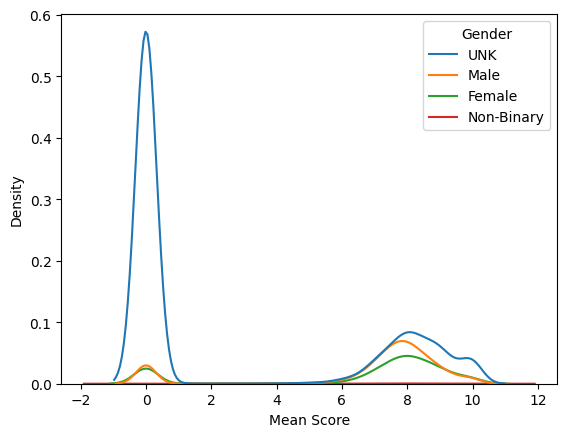

In [ ]:
sns.kdeplot( data = user_detail.sample(frac = 0.5), hue = "Gender", x = "Mean Score")

In [ ]:
#transform the gender column into one hot

user_detail = pd.get_dummies( user_detail, columns = ["Gender"] )

In [ ]:
def min_max_scaling(df):

  max_ = df.max()
  min_ = df.min()

  return ( df - min_ ) / (max_ - min_)

In [ ]:
columns = ['Days Watched', 'Watching', 'Completed', 'On Hold', 'Dropped', 'Plan to Watch', 'Total Entries', 'Rewatched', 'Episodes Watched', "Mean Score"]

user_detail[columns] = min_max_scaling(user_detail[columns])

### Anime

In [ ]:
#exclude columns of generes, producers, licensors and studios
columns = [c for c in anime.columns if "_" not in c ]

The fast progressing of Natural Language Processing ease our work. By common sense the score of anime should be highly dependent on the synopsis of the anime, but unfortunately it is in hard analysis of natural language format. Currently, by BERT we can simply convert the sentences in synopsis into meaningful vector representation that highly ease computer to understand.

In [ ]:
#import bert model and its corresponding preprocessor from tensorflow

bert = hub.load("https://www.kaggle.com/models/tensorflow/bert/frameworks/tensorFlow2/variations/bert-en-uncased-l-10-h-128-a-2/versions/2")
preprocessor = hub.load("https://kaggle.com/models/tensorflow/bert/frameworks/TensorFlow2/variations/en-uncased-preprocess/versions/3")

In [ ]:
#transform the synopsis into vector by bert
#this process take long time, can skip this cell to the next which can restore the vector directly

def preprocessing(row):

  return tf.reduce_mean( bert(preprocessor(row))["sequence_output"], axis = 1 )

#the data is batched into size of 128 due to limited gpu ram
synopsis_data = tf.data.Dataset.from_tensor_slices( anime["Synopsis"] ).batch(128).map(preprocessing).unbatch()
synopsis_vec = np.array([ d for d in synopsis_data.as_numpy_iterator() ])

In [123]:
#if you have run the previous cell, please omit this cell

!wget "https://drive.google.com/uc?export=download&id=1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw" -O synopsis_vec.npy
synopsis_vec = np.load("synopsis_vec.npy")

--2023-11-24 18:21:16--  https://drive.google.com/uc?export=download&id=1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw
Resolving drive.google.com (drive.google.com)... 172.217.15.238, 2607:f8b0:4025:810::200e
Connecting to drive.google.com (drive.google.com)|172.217.15.238|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-14-98-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8l3v1hm5iivt6bdrfl0q6en0oupusic1/1700850075000/11590239380845912113/*/1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw?e=download&uuid=41ff705e-9c25-43b7-8605-99475782f567 [following]
--2023-11-24 18:21:19--  https://doc-14-98-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8l3v1hm5iivt6bdrfl0q6en0oupusic1/1700850075000/11590239380845912113/*/1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw?e=download&uuid=41ff705e-9c25-43b7-8605-99475782f567
Resolving doc-14-98-docs.googleusercontent.com (doc-14-98-docs.googleusercontent.com)... 172.217.12.1, 2607:f8b0:4025:815

Tensorflow provide a tensorboard which can help use to visualize the vector with interactive, the each vector represent one synopsis, and the synopsis with nearest content also should nearer vector representation.

In [138]:
#If the tensorboard does not show anything, please click the inactive, drop down to the bottom and select projector
import os
from tensorboard.plugins import projector

# Set up a logs directory, so Tensorboard knows where to look for files.
log_dir='/logs/synopsis/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

#to reduce file size, only 0.8 of vec is selected
weights = tf.Variable(synopsis_vec[np.random.choice(synopsis_vec.shape[0],int(synopsis_vec.shape[0]*0.8), replace = False ), :], name = "embedding")
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# Set up config.
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "embedding"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

%load_ext tensorboard
%tensorboard --logdir /logs/synopsis/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
#we are not longer need synopsis column
anime.drop("Synopsis", axis = 1, inplace = True)

Due to the spearation of category in column of genres, licensors, producers and studios into one hot lead to dimension explode, we will use target encoding to solve that problem. The approach is calculate the target encoding of each one hot categories, then take the mean so we finally get only one column for each column.

In [ ]:
from sklearn.preprocessing import TargetEncoder

def target_encoding(start):

  columns = anime.columns[ anime.columns.str.startswith(start) ]

  #the rating score in user_score date is the final value we will predict so we have to merge them
  #due to the limited memory and avoid overfitting, we only sampling 0.01 percent of data, but the amount of data still large enough
  data = user_score[["anime_id", "rating"]].sample(frac = 0.01).merge(anime[columns], left_on = "anime_id", right_index = True).drop("anime_id", axis = 1)
  data["rating"] = data.rating.astype("float64")
  x = np.zeros((anime.shape[0],))

  for c in columns:
    target_encoder = TargetEncoder(target_type = "continuous")
    target_encoder.fit(data[[c]], data["rating"])
    x += target_encoder.transform(anime[[c]]).squeeze()


  anime.drop( columns,  axis = 1, inplace = True)
  return x/len(columns)

for i in ["genres_", "proc_", "lic_", "stud_"]:

   anime[i] = target_encoding(i)

By the pairplot we can observe that each of the feature is showing some kind of relationship, but they seem like not showing any relationship with our target which is rating, but from the kde plot in the diagonal, each of them is showing some portion of distribution of target, so we believe that although the single of them does not representative but the combination may have.

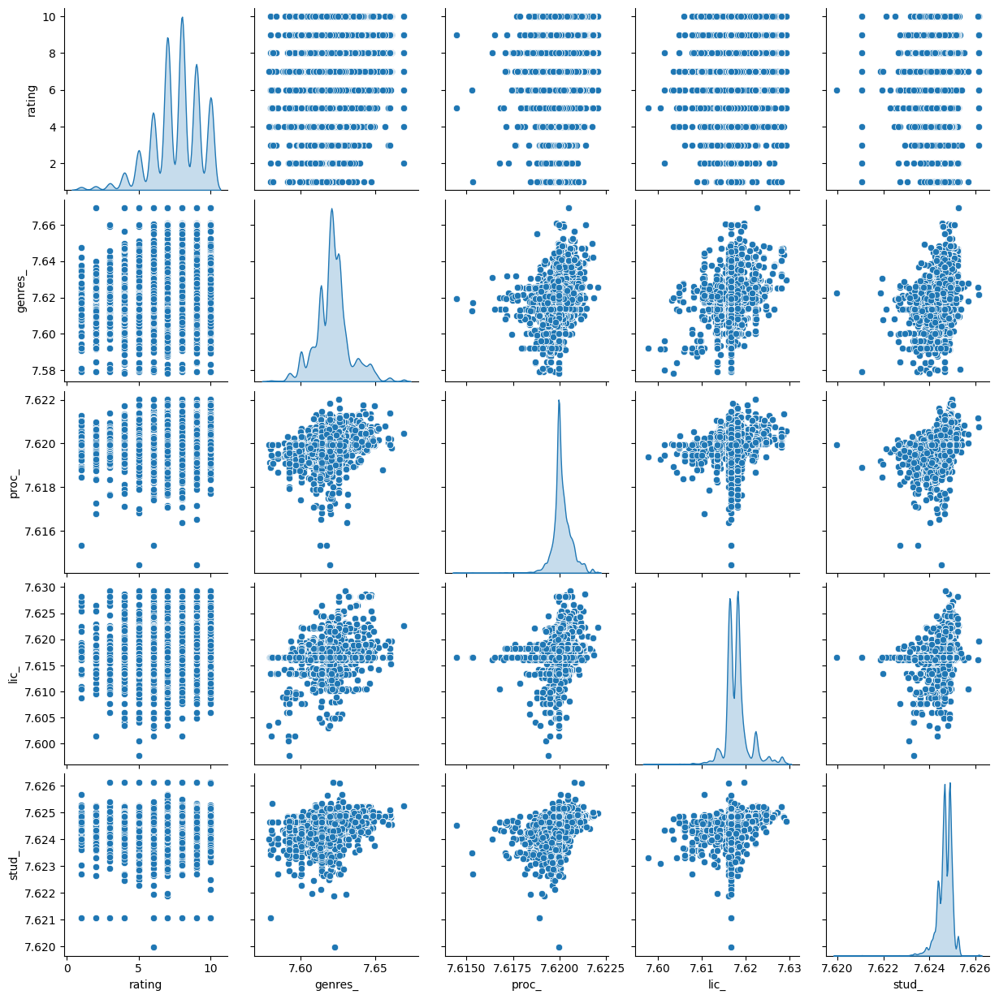

In [ ]:
columns =["genres_", "proc_", "lic_", "stud_"]
sns.pairplot(data = user_score.sample(frac = 0.001).merge(anime[columns], left_on = "anime_id", right_index = True).drop(["user_id", "anime_id"], axis = 1), diag_kind = "kde")

Convert the anime duration to minutes only in integer which is more ease to be processed.

In [ ]:
anime.Duration.unique()[:10]

array(['24 min per ep', '1 hr 55 min', '25 min per ep', '23 min per ep',
       '27 min per ep', '24 min', '22 min per ep', '1 hr 44 min',
       '1 hr 26 min', '1 hr 22 min'], dtype=object)

In [ ]:
def convert_duration(row):

  hour = re.compile(r"\d+ hr").findall(row)
  min = re.compile(r"\d+ min").findall(row)
  sec = re.compile(r"\d+ sec").findall(row)

  duration = 0

  if len(hour) != 0:
    duration += float(hour[0][:-3])*60

  if len(min) != 0:
    duration += float(min[0][:-4])

  if len(sec) != 0:
    duration += float(sec[0][:-4])/60

  return duration

anime["Duration"] = anime.Duration.apply(convert_duration)

Convert column with object datatype which has less than 6 categories into one hot

In [ ]:
#get columns less than six categories
def get_columns(df):

  columns = df.select_dtypes("object").columns

  for c in columns:
    if df[c].unique().shape[0]>5:
      columns = columns.drop(c)

  return columns

In [ ]:
dummy_columns = get_columns(anime)
anime = pd.get_dummies(anime, columns = dummy_columns)

Transform the rest object columns into numerical by target encoding with 0.2 fraction of sample from the target.

In [ ]:
from sklearn.preprocessing import TargetEncoder

object_columns = anime.select_dtypes("object").columns

obj_rating = user_score[["anime_id", "rating"]].sample(frac = 0.2).merge( anime[object_columns], left_on = "anime_id", right_index = True ).drop("anime_id", axis = 1)
target_encoder = TargetEncoder(target_type = "continuous")
target_encoder.fit( obj_rating[object_columns], obj_rating["rating"] )
anime[object_columns] = target_encoder.transform( anime[object_columns])
obj_rating[object_columns] = target_encoder.transform( obj_rating[object_columns] )

From the chart below,we observe that the encoded columns has the properties of multiple peak but there a lot difference in the dispersion of data, the reason may due to the less of categories in our data lead to variant of value lower.

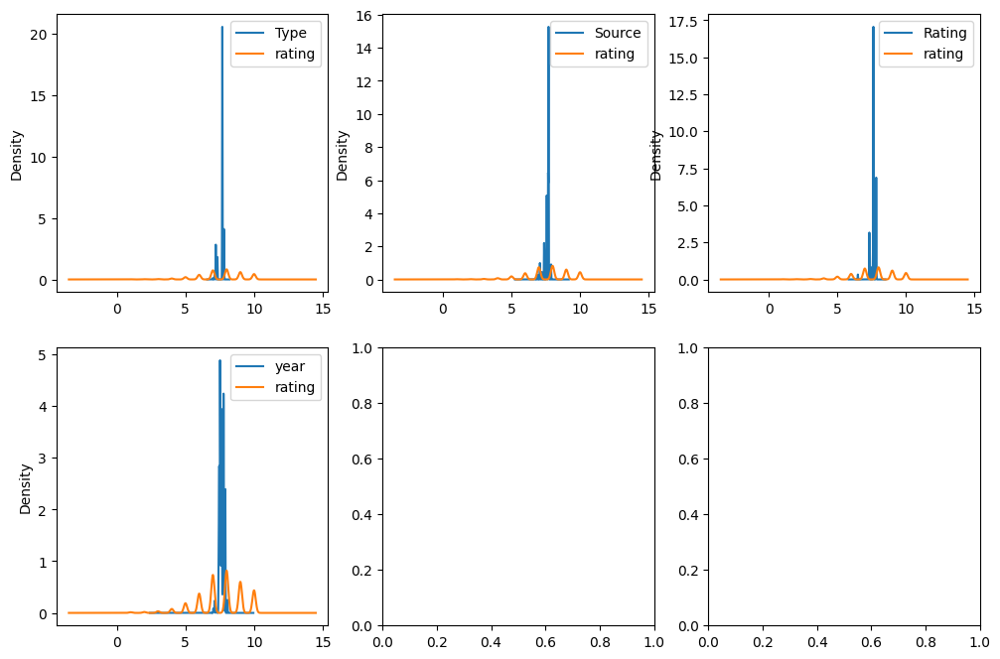

In [ ]:
del zip
fig, ax = plt.subplots(2,3, figsize = (12, 8))
ax = ax.flatten()

for c,a in zip(list(object_columns), ax):
  obj_rating[ [c, "rating"] ].sample(frac = 0.1).plot.kde(ax = a)

In [ ]:
del obj_rating
gc.collect()

27

## Feature Creation and Further Feature Selection

In this part, some of new feature will be created which can provide more information or ease to be process by machine based on domain knowledge. Other than that, further feature selection based on mutual information also will be conducted instead of just based on the intuition

### User Detail

The birthday column is converted to age which believed will be more informative.

In [ ]:
user_detail["Birthday"] = ( np.datetime64("2023-11-17") - np.array(user_detail["Birthday"], dtype = "datetime64[D]") ) / np.timedelta64("365", "D")
user_detail["Birthday"] = min_max_scaling(user_detail["Birthday"])

In [ ]:
col_rating = user_score.sample(frac = 0.1).merge(user_detail, left_on = "user_id", right_index = True).drop(["user_id", "anime_id"], axis = 1)

The graph below is showing the distrbution of rating againts each column, seem like most of them is nearly independent with our target which is rating

In [ ]:
columns = ['Birthday', 'Days Watched', 'Watching', 'Completed', 'On Hold', 'Dropped', 'Plan to Watch', 'Total Entries', 'Rewatched', 'Episodes Watched']

#merge with target column
col_rating = user_score.sample(frac = 0.1).merge(user_detail[columns], left_on = "user_id", right_index = True)

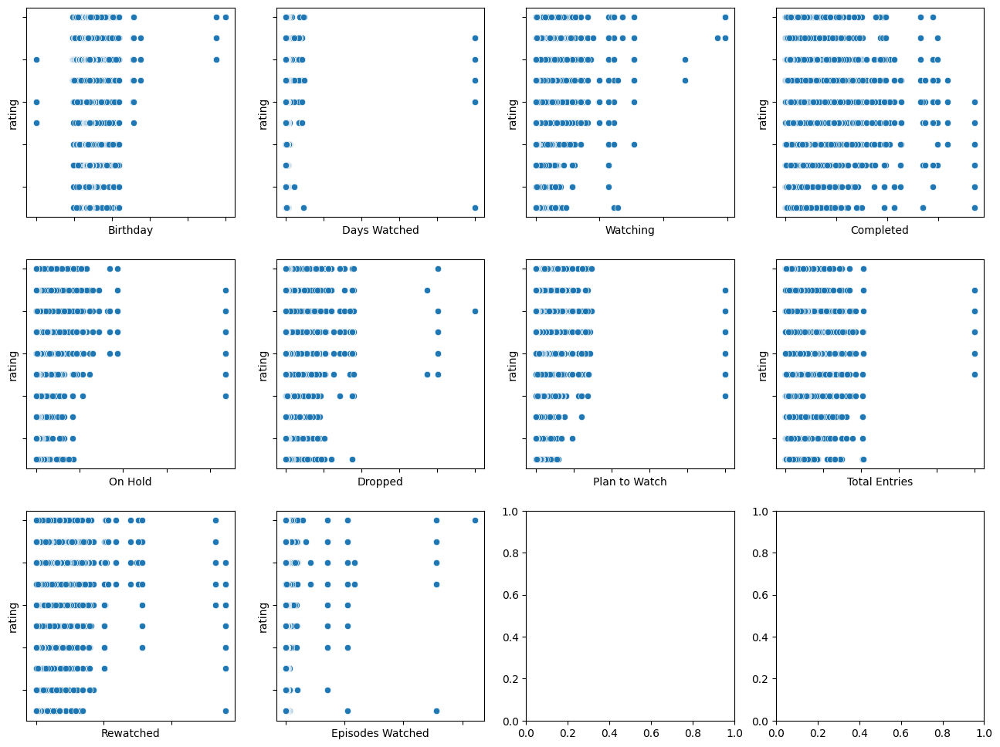

In [ ]:
fig, ax = plt.subplots(3, 4, figsize = (16,12) )
ax = ax.flatten()

for i, col in enumerate( col_rating.columns.drop(["rating","user_id", "anime_id"]) ):
  sns.scatterplot(data = col_rating[["rating", col]].sample(frac = 0.4), x = col, y = "rating", ax = ax[i])
  ax[i].tick_params(axis = "x", labelbottom = False)
  ax[i].tick_params(axis = "y", labelleft = False)

In [ ]:
del col_rating
gc.collect()

0

Nextly, we will conducting feature selection based on mutual information, but before that we have to join user detail with the rating column which is our target in user_score

In [ ]:
from sklearn.feature_selection import mutual_info_regression

columns = user_detail.columns

#merging user score and user detail
user_rating = user_score.sample(frac = 0.1).merge( user_detail, left_on = "user_id", right_index = True ).drop(["user_id", "anime_id"], axis = 1)

#conducting mutual information
mi_user_detail = mutual_info_regression(user_rating[columns] , user_rating[ "rating" ])
mi_user_detail = pd.Series(mi_user_detail, index = columns,  name = "MI Scores"  ).sort_values(ascending = False)

In [ ]:
mi_user_detail

Mean Score           0.161312
Episodes Watched     0.071261
Days Watched         0.036920
Total Entries        0.034952
Completed            0.034557
Birthday             0.022222
Dropped              0.020749
Plan to Watch        0.007524
On Hold              0.006653
Rewatched            0.005992
Watching             0.002148
Gender_Male          0.002037
Gender_Female        0.001195
Gender_UNK           0.000549
Gender_Non-Binary    0.000065
Name: MI Scores, dtype: float64

We only select the top most 8 to retain

In [ ]:
dropped_user_detail_col = list(mi_user_detail[8:].index )
dropped_user_detail_col

['On Hold',
 'Rewatched',
 'Watching',
 'Gender_Male',
 'Gender_Female',
 'Gender_UNK',
 'Gender_Non-Binary']

In [ ]:
user_detail = user_detail.drop(dropped_user_detail_col, axis = 1)

del user_rating
gc.collect()

27

### Anime

The high dimensional vector is hard to stored in pandas, our solution is to do discretization, by using kmeans to divide the vector into ten difference cluster and store it as new column.

In [ ]:
from sklearn.cluster import KMeans

kmean = KMeans(n_clusters = 10).fit(synopsis_vec)
anime["Synopsis_cat"] = kmean.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Conducting the mutual information for anime, but before that have to join with the target which is the rating in user score

In [ ]:
from sklearn.feature_selection import mutual_info_regression

anime_rating = user_score[["anime_id", "rating"]].sample(frac = 0.1).merge( anime, left_on = "anime_id", right_index = True ).drop("anime_id", axis = 1)
mi_anime = mutual_info_regression(anime_rating.drop("rating", axis = 1) , anime_rating[ "rating" ])
mi_anime = pd.Series(mi_anime, index = anime.columns, name = "MI Scores"  ).sort_values(ascending = False)

In [ ]:
mi_anime

Members                    0.109832
Rank                       0.108403
Scored By                  0.108394
Popularity                 0.105879
Score                      0.095174
Favorites                  0.086521
proc_                      0.083968
genres_                    0.049607
stud_                      0.037566
lic_                       0.026672
Episodes                   0.018113
Duration                   0.018059
year                       0.008038
Type                       0.007479
Rating                     0.007441
Source                     0.006341
Synopsis_cat               0.006275
spring_fall                0.001638
Status_Currently Airing    0.001429
Status_Not yet aired       0.001192
Status_Finished Airing     0.001031
spring_spring              0.000745
spring_summer              0.000361
spring_UNK                 0.000274
spring_winter              0.000251
Name: MI Scores, dtype: float64

We decide to drop the 10 of the lowest mutual information columns.

In [ ]:
mi_anime[-10:].index
anime.drop( mi_anime[-10:].index, inplace = True, axis = 1 )

In [ ]:
del anime_rating
gc.collect()

3424

### User Score

The last step is to merging three of the data into a single dataset. Due to that step will lead to a very huge dataset, we only can join them chunks bu chunks which in this case is 10000 of size, and write them one by one into one into a csv file.

In [114]:
header = True
for i in range(0, user_score.size, 10000 ):
  merge_df = user_score.iloc[ i:min(i+10000, user_score.size), : ].merge(anime, left_on = "anime_id", right_index = True)
  merge_df = merge_df.merge(user_detail, left_on = "user_id", right_index = True)
  merge_df = merge_df.to_csv("anime_data.csv", mode = "a", header = header)

  header = False

In [ ]:
!ls -l

total 15249132
-rw-r--r-- 1 root root 8249855685 Nov 24 14:54 anime_data.csv
-rw-r--r-- 1 root root   15924739 Nov 24 12:56 anime-dataset-2023.csv
-rw-r--r-- 1 root root    9722413 Nov 24 12:56 anime-filtered.csv
-rw-r--r-- 1 root root 4549801910 Nov 24 12:57 final_animedataset.csv
drwxr-xr-x 1 root root       4096 Nov 21 14:24 sample_data
-rw-r--r-- 1 root root   12751488 Nov 24 10:52 synopsis_vec.npy
-rw-r--r-- 1 root root 1545214210 Nov 24 12:57 user-filtered.csv
-rw-r--r-- 1 root root   73927314 Nov 24 12:57 users-details-2023.csv
-rw-r--r-- 1 root root 1157881770 Nov 24 12:57 users-score-2023.csv


In [122]:
next(pd.read_csv("anime_data.csv", chunksize = 100, index_col = 0)).head()

,user_id,anime_id,rating,Score,Type,Episodes,Duration,Rating,Rank,Popularity,...,lic_,stud_,Birthday,Days Watched,Mean Score,Completed,Dropped,Plan to Watch,Total Entries,Episodes Watched
0,1,21,9,8.69,7.685813,25.0,24.0,7.625909,55.000000,20,...,7.621920,7.615212,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
1,1,48,7,6.95,7.685813,26.0,24.0,7.625909,4172.000000,1243,...,7.623912,7.615039,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
2,1,320,5,6.54,7.209165,2.0,26.0,6.497936,9960.770167,2485,...,7.615104,7.615048,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
3,1,49,8,7.29,7.209165,5.0,30.0,7.625909,2542.000000,2832,...,7.615631,7.614986,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
4,1,304,8,7.54,7.800121,1.0,106.0,7.625909,1590.000000,3195,...,7.616281,7.614986,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
